In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import warnings
warnings.filterwarnings('ignore')
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import ConfusionMatrixDisplay, RocCurveDisplay
from xgboost import XGBRFClassifier, XGBClassifier
%matplotlib inline

In [2]:
def plot_correlation(df):
    '''
    This function is resposible to plot a correlation map among features in the dataset
    '''
    corr = np.round(df.corr(), 2)
    mask = np.triu(np.ones_like(corr, dtype = bool))
    c_mask = np.where(~mask, corr, 100)

    c = []
    for i in c_mask.tolist()[1:]:
        c.append([x for x in i if x != 100])


    
    fig = ff.create_annotated_heatmap(z=c[::-1],
                                      x=corr.index.tolist()[:-1],
                                      y=corr.columns.tolist()[1:][::-1],
                                      colorscale = 'Magenta')

    fig.update_layout(title = {'text': '<b>&nbsp;&nbsp;&nbsp;Feature Correlation <br><sup>&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;<i>Heatmap</i></sup></b>',
                                'x': 0, 'xanchor': 'left'},
                    margin = dict(t=210, l = 110),
                    yaxis = dict(autorange = 'reversed', showgrid = False),
                    xaxis = dict(showgrid = False),
                    plot_bgcolor = '#F6F5F5',
                    paper_bgcolor = '#F6F5F5',
                    height = 950, width = 950)
                     

    fig.add_trace(go.Heatmap(z = c[::-1],
                             colorscale = 'Magenta',
                             showscale = True,
                             visible = False))
    fig.data[1].visible = True

    for i in range(len(fig.layout.annotations)):
        fig.layout.annotations[i].font.size = 12

    fig.show()

In [3]:
loan_data = pd.read_csv(r"loan_data_2007_2014.csv")

In [4]:
pd.set_option('display.min_rows', 500)
pd.set_option('display.max_columns', None)  # Show all columns
pd.set_option('display.expand_frame_repr', False)  # Prevent line wrapping

In [5]:
loan_data.head(5)

,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m
0,0,1077501,1296599,5000,5000,4975.0,36 months,10.65,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0.0,Jan-85,1.0,NaN,NaN,3.0,0.0,13648,83.7,9.0,f,0.0,0.0,5861.071414,5831.78,5000.00,861.07,0.00,0.00,0.00,Jan-15,171.62,NaN,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1077430,1314167,2500,2500,2500.0,60 months,15.27,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-11,Charged Off,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0.0,Apr-99,5.0,NaN,NaN,3.0,0.0,1687,9.4,4.0,f,0.0,0.0,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-13,119.66,NaN,Sep-13,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,1077175,1313524,2400,2400,2400.0,36 months,15.96,84.33,C,C5,NaN,10+ years,RENT,12252.0,Not Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,NaN,small_business,real estate business,606xx,IL,8.72,0.0,Nov-01,2.0,NaN,NaN,2.0,0.0,2956,98.5,10.0,f,0.0,0.0,3003.653644,3003.65,2400.00,603.65,0.00,0.00,0.00,Jun-14,649.91,NaN,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,1076863,1277178,10000,10000,10000.0,36 months,13.49,339.31,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.0,Source Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0.0,Feb-96,1.0,35.0,NaN,10.0,0.0,5598,21.0,37.0,f,0.0,0.0,12226.302210,12226.30,10000.00,2209.33,16.97,0.00,0.00,Jan-15,357.48,NaN,Jan-15,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,1075358,1311748,3000,3000,3000.0,60 months,12.69,67.79,B,B5,University Medical Group,1 year,RENT,80000.0,Source Verified,Dec-11,Current,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/21/11 > I plan on combi...,other,Personal,972xx,OR,17.94,0.0,Jan-96,0.0,38.0,NaN,15.0,0.0,27783,53.9,38.0,f,766.9,766.9,3242.170000,3242.17,2233.10,1009.07,0.00,0.00,0.00,Jan-16,67.79,Feb-16,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
loan_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 466285 entries, 0 to 466284
Data columns (total 75 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   Unnamed: 0                   466285 non-null  int64  
 1   id                           466285 non-null  int64  
 2   member_id                    466285 non-null  int64  
 3   loan_amnt                    466285 non-null  int64  
 4   funded_amnt                  466285 non-null  int64  
 5   funded_amnt_inv              466285 non-null  float64
 6   term                         466285 non-null  object 
 7   int_rate                     466285 non-null  float64
 8   installment                  466285 non-null  float64
 9   grade                        466285 non-null  object 
 10  sub_grade                    466285 non-null  object 
 11  emp_title                    438697 non-null  object 
 12  emp_length                   445277 non-null  object 
 13 

## Data Pre-processing

In [7]:
# selecting the important continous and discrete columns for analysis.

In [8]:
categorical_columns = ['grade','sub_grade','home_ownership','verification_status',
                 'loan_status','purpose','addr_state','initial_list_status']


In [9]:
df_Dummies = pd.DataFrame()
for col in categorical_columns:
  df_Dummy= pd.get_dummies(loan_data[col], prefix = col, prefix_sep = ':')
  df_Dummies = pd.concat([df_Dummies,df_Dummy ], axis=1)

In [10]:
df_Dummies.head()

,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,grade:G,sub_grade:A1,sub_grade:A2,sub_grade:A3,sub_grade:A4,sub_grade:A5,sub_grade:B1,sub_grade:B2,sub_grade:B3,sub_grade:B4,sub_grade:B5,sub_grade:C1,sub_grade:C2,sub_grade:C3,sub_grade:C4,sub_grade:C5,sub_grade:D1,sub_grade:D2,sub_grade:D3,sub_grade:D4,sub_grade:D5,sub_grade:E1,sub_grade:E2,sub_grade:E3,sub_grade:E4,sub_grade:E5,sub_grade:F1,sub_grade:F2,sub_grade:F3,sub_grade:F4,sub_grade:F5,sub_grade:G1,sub_grade:G2,sub_grade:G3,sub_grade:G4,sub_grade:G5,home_ownership:ANY,home_ownership:MORTGAGE,home_ownership:NONE,home_ownership:OTHER,home_ownership:OWN,home_ownership:RENT,verification_status:Not Verified,verification_status:Source Verified,verification_status:Verified,loan_status:Charged Off,loan_status:Current,loan_status:Default,loan_status:Does not meet the credit policy. Status:Charged Off,loan_status:Does not meet the credit policy. Status:Fully Paid,loan_status:Fully Paid,loan_status:In Grace Period,loan_status:Late (16-30 days),loan_status:Late (31-120 days),purpose:car,purpose:credit_card,purpose:debt_consolidation,purpose:educational,purpose:home_improvement,purpose:house,purpose:major_purchase,purpose:medical,purpose:moving,purpose:other,purpose:renewable_energy,purpose:small_business,purpose:vacation,purpose:wedding,addr_state:AK,addr_state:AL,addr_state:AR,addr_state:AZ,addr_state:CA,addr_state:CO,addr_state:CT,addr_state:DC,addr_state:DE,addr_state:FL,addr_state:GA,addr_state:HI,addr_state:IA,addr_state:ID,addr_state:IL,addr_state:IN,addr_state:KS,addr_state:KY,addr_state:LA,addr_state:MA,addr_state:MD,addr_state:ME,addr_state:MI,addr_state:MN,addr_state:MO,addr_state:MS,addr_state:MT,addr_state:NC,addr_state:NE,addr_state:NH,addr_state:NJ,addr_state:NM,addr_state:NV,addr_state:NY,addr_state:OH,addr_state:OK,addr_state:OR,addr_state:PA,addr_state:RI,addr_state:SC,addr_state:SD,addr_state:TN,addr_state:TX,addr_state:UT,addr_state:VA,addr_state:VT,addr_state:WA,addr_state:WI,addr_state:WV,addr_state:WY,initial_list_status:f,initial_list_status:w
0,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False
1,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,True,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False
2,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,F

In [11]:
#merging dummy columns with the main dataset
loan_data = pd.concat([loan_data,df_Dummies],axis = 1)

In [12]:
# converting the employement lenght column into a continous integer format
loan_data['emp_length'].unique()

array(['10+ years', '< 1 year', '1 year', '3 years', '8 years', '9 years',
       '4 years', '5 years', '6 years', '2 years', '7 years', nan],
      dtype=object)

In [13]:
loan_data['emp_length_int']= loan_data['emp_length'].str.replace('+ years','')
loan_data['emp_length_int']= loan_data['emp_length_int'].str.replace('< 1 year',str(0))
loan_data['emp_length_int']= loan_data['emp_length_int'].str.replace('n/a',str(0))
loan_data['emp_length_int']= loan_data['emp_length_int'].str.replace(' years','')
loan_data['emp_length_int']= loan_data['emp_length_int'].str.replace(' year','')

In [14]:
loan_data.head()

,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,grade:G,sub_grade:A1,sub_grade:A2,sub_grade:A3,sub_grade:A4,sub_grade:A5,sub_grade:B1,sub_grade:B2,sub_grade:B3,sub_grade:B4,sub_grade:B5,sub_grade:C1,sub_grade:C2,sub_grade:C3,sub_grade:C4,sub_grade:C5,sub_grade:D1,sub_grade:D2,sub_grade:D3,sub_grade:D4,sub_grade:D5,sub_grade:E1,sub_grade:E2,sub_grade:E3,sub_grade:E4,sub_grade:E5,sub_grade:F1,sub_grade:F2,sub_grade:F3,sub_grade:F4,sub_grade:F5,sub_grade:G1,sub_grade:G2,sub_grade:G3,sub_grade:G4,sub_grade:G5,home_ownership:ANY,home_ownership:MORTGAGE,home_ownership:NONE,home_ownership:OTHER,home_ownership:OWN,home_ownership:RENT,verification_status:Not Verified,verification_status:Source Verified,verification_status:Verified,loan_status:Charged Off,loan_status:Current,loan_status:Default,loan_status:Does not meet the credit policy. Status:Charged Off,loan_status:Does not meet the credit policy. Status:Fully Paid,loan_status:Fully Paid,loan_status:In Grace Period,loan_status:Late (16-30 days),loan_status:Late (31-120 days),purpose:car,purpose:credit_card,purpose:debt_consolidation,purpose:educational,purpose:home_improvement,purpose:house,purpose:major_purchase,purpose:medical,purpose:moving,purpose:other,purpose:renewable_energy,purpose:small_business,purpose:vacation,purpose:wedding,addr_state:AK,addr_state:AL,addr_state:AR,addr_state:AZ,addr_state:CA,addr_state:CO,addr_state:CT,addr_state:DC,addr_state:DE,addr_state:FL,addr_state:GA,addr_state:HI,addr_state:IA,addr_state:ID,addr_state:IL,addr_state:IN,addr_state:KS,addr_state:KY,addr_state:LA,addr_state:MA,addr_state:MD,addr_state:ME,addr_state:MI,addr_state:MN,addr_state:MO,addr_state:MS,addr_state:MT,addr_state:NC,addr_state:NE,addr_state:NH,addr_state:NJ,addr_state:NM,addr_state:NV,addr_state:NY,addr_state:OH,addr_state:OK,addr_state:OR,addr_state:PA,addr_state:RI,addr_state:SC,addr_state:SD,addr_state:TN,addr_state:TX,addr_state:UT,addr_state:VA,addr_state:VT,addr_state:WA,addr_state:WI,addr_state:WV,addr_state:WY,initial_list_status:f,initial_list_status:w,emp_length_int
0,0,1077501,1296599,5000,5000,4975.0,36 months,10.65,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0.0,Jan-85,1.0,NaN,NaN,3.0,0.0,13648,83.7,9.0,f,0.0,0.0,5861.071414,5831.78,5000.00,861.07,0.00,0.00,0.00,Jan-15,171.62,NaN,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,F

In [15]:
loan_data['emp_length_int']=pd.to_numeric(loan_data['emp_length_int'])

In [16]:
loan_data['earliest_cr_line']

0         Jan-85
1         Apr-99
2         Nov-01
3         Feb-96
4         Jan-96
5         Nov-04
6         Jul-05
7         Jan-07
8         Apr-04
9         Sep-04
10        Jan-98
11        Oct-89
12        Apr-04
13        Jul-03
14        May-91
15        Sep-07
16        Oct-98
17        Aug-93
18        Oct-03
19        Jan-01
20        Nov-97
21        Feb-83
22        Jul-85
23        Apr-03
24        Jun-01
25        Feb-02
26        Oct-03
27        Oct-03
28        Aug-84
29        Nov-06
           ...  
466255    Sep-00
466256    Apr-01
466257    Jul-85
466258    Jun-93
466259    Apr-85
466260    Sep-97
466261    Aug-97
466262    Feb-93
466263    Jul-98
466264    Aug-03
466265    Jul-93
466266    Mar-94
466267    Oct-02
466268    Dec-01
466269    Apr-00
466270    Oct-86
466271    Dec-93
466272    Jun-01
466273    May-90
466274    Aug-83
466275    Nov-93
466276    Nov-94
466277    Jul-98
466278    Jun-02
466279    Aug-99
466280    Apr-03
466281    Jun-97
466282    Dec-

In [17]:
# why this particular date -
loan_data['earliest_cr_line_date']=pd.to_datetime(loan_data['earliest_cr_line'],format = '%b-%y')
#calculating the months since a default date taken as 2017-12-01
diff_cr_line = pd.to_datetime('2017-12-01') - loan_data['earliest_cr_line_date']
loan_data['mths_since_earliest_cr_line'] = round(pd.to_numeric( diff_cr_line / np.timedelta64(1, 'm')))

<Axes: >

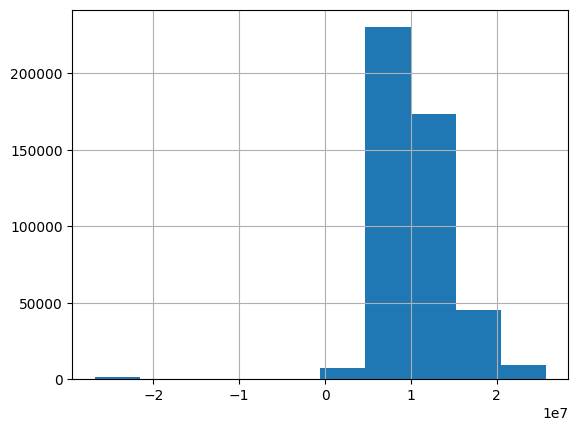

In [18]:
loan_data['mths_since_earliest_cr_line'].hist()

In [19]:
#finding out why there are negative values in our dataset
m1 = loan_data['mths_since_earliest_cr_line']<0
loan_data.loc[m1,['earliest_cr_line','earliest_cr_line_date','mths_since_earliest_cr_line']].head()

,earliest_cr_line,earliest_cr_line_date,mths_since_earliest_cr_line
1580,Sep-62,2062-09-01,-23536800.0
1770,Sep-68,2068-09-01,-26693280.0
2799,Sep-64,2064-09-01,-24589440.0
3282,Sep-67,2067-09-01,-26166240.0
3359,Feb-65,2065-02-01,-24809760.0


In [20]:
# it is neccessary to handle negative values. they are due to the 196x data read as 206x
# we take the maximum month difference to replace negative values
loan_data.loc[m1,'mths_since_earliest_cr_line'] = loan_data.loc[:,'mths_since_earliest_cr_line'].max()

In [21]:


loan_data.head()

,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,grade:G,sub_grade:A1,sub_grade:A2,sub_grade:A3,sub_grade:A4,sub_grade:A5,sub_grade:B1,sub_grade:B2,sub_grade:B3,sub_grade:B4,sub_grade:B5,sub_grade:C1,sub_grade:C2,sub_grade:C3,sub_grade:C4,sub_grade:C5,sub_grade:D1,sub_grade:D2,sub_grade:D3,sub_grade:D4,sub_grade:D5,sub_grade:E1,sub_grade:E2,sub_grade:E3,sub_grade:E4,sub_grade:E5,sub_grade:F1,sub_grade:F2,sub_grade:F3,sub_grade:F4,sub_grade:F5,sub_grade:G1,sub_grade:G2,sub_grade:G3,sub_grade:G4,sub_grade:G5,home_ownership:ANY,home_ownership:MORTGAGE,home_ownership:NONE,home_ownership:OTHER,home_ownership:OWN,home_ownership:RENT,verification_status:Not Verified,verification_status:Source Verified,verification_status:Verified,loan_status:Charged Off,loan_status:Current,loan_status:Default,loan_status:Does not meet the credit policy. Status:Charged Off,loan_status:Does not meet the credit policy. Status:Fully Paid,loan_status:Fully Paid,loan_status:In Grace Period,loan_status:Late (16-30 days),loan_status:Late (31-120 days),purpose:car,purpose:credit_card,purpose:debt_consolidation,purpose:educational,purpose:home_improvement,purpose:house,purpose:major_purchase,purpose:medical,purpose:moving,purpose:other,purpose:renewable_energy,purpose:small_business,purpose:vacation,purpose:wedding,addr_state:AK,addr_state:AL,addr_state:AR,addr_state:AZ,addr_state:CA,addr_state:CO,addr_state:CT,addr_state:DC,addr_state:DE,addr_state:FL,addr_state:GA,addr_state:HI,addr_state:IA,addr_state:ID,addr_state:IL,addr_state:IN,addr_state:KS,addr_state:KY,addr_state:LA,addr_state:MA,addr_state:MD,addr_state:ME,addr_state:MI,addr_state:MN,addr_state:MO,addr_state:MS,addr_state:MT,addr_state:NC,addr_state:NE,addr_state:NH,addr_state:NJ,addr_state:NM,addr_state:NV,addr_state:NY,addr_state:OH,addr_state:OK,addr_state:OR,addr_state:PA,addr_state:RI,addr_state:SC,addr_state:SD,addr_state:TN,addr_state:TX,addr_state:UT,addr_state:VA,addr_state:VT,addr_state:WA,addr_state:WI,addr_state:WV,addr_state:WY,initial_list_status:f,initial_list_status:w,emp_length_int,earliest_cr_line_date,mths_since_earliest_cr_line
0,0,1077501,1296599,5000,5000,4975.0,36 months,10.65,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0.0,Jan-85,1.0,NaN,NaN,3.0,0.0,13648,83.7,9.0,f,0.0,0.0,5861.071414,5831.78,5000.00,861.07,0.00,0.00,0.00,Jan-15,171.62,NaN,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,Fals

In [22]:
#let's convert term column to integer format
loan_data['term']

0          36 months
1          60 months
2          36 months
3          36 months
4          60 months
5          36 months
6          60 months
7          36 months
8          60 months
9          60 months
10         60 months
11         36 months
12         36 months
13         36 months
14         36 months
15         36 months
16         36 months
17         36 months
18         36 months
19         36 months
20         60 months
21         36 months
22         36 months
23         36 months
24         36 months
25         36 months
26         36 months
27         60 months
28         36 months
29         36 months
             ...    
466255     36 months
466256     36 months
466257     36 months
466258     36 months
466259     36 months
466260     36 months
466261     36 months
466262     36 months
466263     36 months
466264     36 months
466265     36 months
466266     36 months
466267     36 months
466268     36 months
466269     60 months
466270     36 months
466271     36

In [23]:
loan_data['term_int'] = loan_data['term'].str.replace(' months', '').astype(int)
loan_data['term_int'].describe()

count    466285.000000
mean         42.605334
std          10.719040
min          36.000000
25%          36.000000
50%          36.000000
75%          60.000000
max          60.000000
Name: term_int, dtype: float64

In [24]:
loan_data.head()

,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,grade:G,sub_grade:A1,sub_grade:A2,sub_grade:A3,sub_grade:A4,sub_grade:A5,sub_grade:B1,sub_grade:B2,sub_grade:B3,sub_grade:B4,sub_grade:B5,sub_grade:C1,sub_grade:C2,sub_grade:C3,sub_grade:C4,sub_grade:C5,sub_grade:D1,sub_grade:D2,sub_grade:D3,sub_grade:D4,sub_grade:D5,sub_grade:E1,sub_grade:E2,sub_grade:E3,sub_grade:E4,sub_grade:E5,sub_grade:F1,sub_grade:F2,sub_grade:F3,sub_grade:F4,sub_grade:F5,sub_grade:G1,sub_grade:G2,sub_grade:G3,sub_grade:G4,sub_grade:G5,home_ownership:ANY,home_ownership:MORTGAGE,home_ownership:NONE,home_ownership:OTHER,home_ownership:OWN,home_ownership:RENT,verification_status:Not Verified,verification_status:Source Verified,verification_status:Verified,loan_status:Charged Off,loan_status:Current,loan_status:Default,loan_status:Does not meet the credit policy. Status:Charged Off,loan_status:Does not meet the credit policy. Status:Fully Paid,loan_status:Fully Paid,loan_status:In Grace Period,loan_status:Late (16-30 days),loan_status:Late (31-120 days),purpose:car,purpose:credit_card,purpose:debt_consolidation,purpose:educational,purpose:home_improvement,purpose:house,purpose:major_purchase,purpose:medical,purpose:moving,purpose:other,purpose:renewable_energy,purpose:small_business,purpose:vacation,purpose:wedding,addr_state:AK,addr_state:AL,addr_state:AR,addr_state:AZ,addr_state:CA,addr_state:CO,addr_state:CT,addr_state:DC,addr_state:DE,addr_state:FL,addr_state:GA,addr_state:HI,addr_state:IA,addr_state:ID,addr_state:IL,addr_state:IN,addr_state:KS,addr_state:KY,addr_state:LA,addr_state:MA,addr_state:MD,addr_state:ME,addr_state:MI,addr_state:MN,addr_state:MO,addr_state:MS,addr_state:MT,addr_state:NC,addr_state:NE,addr_state:NH,addr_state:NJ,addr_state:NM,addr_state:NV,addr_state:NY,addr_state:OH,addr_state:OK,addr_state:OR,addr_state:PA,addr_state:RI,addr_state:SC,addr_state:SD,addr_state:TN,addr_state:TX,addr_state:UT,addr_state:VA,addr_state:VT,addr_state:WA,addr_state:WI,addr_state:WV,addr_state:WY,initial_list_status:f,initial_list_status:w,emp_length_int,earliest_cr_line_date,mths_since_earliest_cr_line,term_int
0,0,1077501,1296599,5000,5000,4975.0,36 months,10.65,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0.0,Jan-85,1.0,NaN,NaN,3.0,0.0,13648,83.7,9.0,f,0.0,0.0,5861.071414,5831.78,5000.00,861.07,0.00,0.00,0.00,Jan-15,171.62,NaN,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,F

In [25]:
# Assuming we are in December 2017
loan_data['issue_d_date'] = pd.to_datetime(loan_data['issue_d'], format = '%b-%y')

#calculating the month difference from 2017-12-01
# We calculate the difference between two dates in months, turn it to numeric datatype and round it.
diff_issue_d = pd.to_datetime('2017-12-01') - loan_data['issue_d_date']

# Convert the difference from days to months manually
loan_data['mths_since_issue_d'] = round(diff_issue_d.dt.days / 30)


loan_data.head()

,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,grade:A,grade:B,grade:C,grade:D,grade:E,grade:F,grade:G,sub_grade:A1,sub_grade:A2,sub_grade:A3,sub_grade:A4,sub_grade:A5,sub_grade:B1,sub_grade:B2,sub_grade:B3,sub_grade:B4,sub_grade:B5,sub_grade:C1,sub_grade:C2,sub_grade:C3,sub_grade:C4,sub_grade:C5,sub_grade:D1,sub_grade:D2,sub_grade:D3,sub_grade:D4,sub_grade:D5,sub_grade:E1,sub_grade:E2,sub_grade:E3,sub_grade:E4,sub_grade:E5,sub_grade:F1,sub_grade:F2,sub_grade:F3,sub_grade:F4,sub_grade:F5,sub_grade:G1,sub_grade:G2,sub_grade:G3,sub_grade:G4,sub_grade:G5,home_ownership:ANY,home_ownership:MORTGAGE,home_ownership:NONE,home_ownership:OTHER,home_ownership:OWN,home_ownership:RENT,verification_status:Not Verified,verification_status:Source Verified,verification_status:Verified,loan_status:Charged Off,loan_status:Current,loan_status:Default,loan_status:Does not meet the credit policy. Status:Charged Off,loan_status:Does not meet the credit policy. Status:Fully Paid,loan_status:Fully Paid,loan_status:In Grace Period,loan_status:Late (16-30 days),loan_status:Late (31-120 days),purpose:car,purpose:credit_card,purpose:debt_consolidation,purpose:educational,purpose:home_improvement,purpose:house,purpose:major_purchase,purpose:medical,purpose:moving,purpose:other,purpose:renewable_energy,purpose:small_business,purpose:vacation,purpose:wedding,addr_state:AK,addr_state:AL,addr_state:AR,addr_state:AZ,addr_state:CA,addr_state:CO,addr_state:CT,addr_state:DC,addr_state:DE,addr_state:FL,addr_state:GA,addr_state:HI,addr_state:IA,addr_state:ID,addr_state:IL,addr_state:IN,addr_state:KS,addr_state:KY,addr_state:LA,addr_state:MA,addr_state:MD,addr_state:ME,addr_state:MI,addr_state:MN,addr_state:MO,addr_state:MS,addr_state:MT,addr_state:NC,addr_state:NE,addr_state:NH,addr_state:NJ,addr_state:NM,addr_state:NV,addr_state:NY,addr_state:OH,addr_state:OK,addr_state:OR,addr_state:PA,addr_state:RI,addr_state:SC,addr_state:SD,addr_state:TN,addr_state:TX,addr_state:UT,addr_state:VA,addr_state:VT,addr_state:WA,addr_state:WI,addr_state:WV,addr_state:WY,initial_list_status:f,initial_list_status:w,emp_length_int,earliest_cr_line_date,mths_since_earliest_cr_line,term_int,issue_d_date,mths_since_issue_d
0,0,1077501,1296599,5000,5000,4975.0,36 months,10.65,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-11,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0.0,Jan-85,1.0,NaN,NaN,3.0,0.0,13648,83.7,9.0,f,0.0,0.0,5861.071414,5831.78,5000.00,861.07,0.00,0.00,0.00,Jan-15,171.62,NaN,Jan-16,0.0,NaN,1,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False

In [26]:
loan_data['mths_since_issue_d'].describe()

count    466285.000000
mean         52.265887
std          14.385250
min          37.000000
25%          42.000000
50%          48.000000
75%          58.000000
max         128.000000
Name: mths_since_issue_d, dtype: float64

In [27]:
#checking for missing Values
pd.options.display.max_rows = None
loan_data.isnull().sum().sort_index()/len(loan_data)

Unnamed: 0                                                         0.000000
acc_now_delinq                                                     0.000062
addr_state                                                         0.000000
addr_state:AK                                                      0.000000
addr_state:AL                                                      0.000000
addr_state:AR                                                      0.000000
addr_state:AZ                                                      0.000000
addr_state:CA                                                      0.000000
addr_state:CO                                                      0.000000
addr_state:CT                                                      0.000000
addr_state:DC                                                      0.000000
addr_state:DE                                                      0.000000
addr_state:FL                                                      0.000000
addr_state:G

In [28]:
# we use funded_amnt for the missing total_rev_hi_lim values
# fundedAmnt The total amount committed to that loan at that point in time.
loan_data['total_rev_hi_lim'].fillna(loan_data['funded_amnt'],inplace = True)

In [29]:
# for the missing values in annual_inc, mean value is considered.  
loan_data['annual_inc'].fillna(loan_data['annual_inc'].mean(),inplace = True)

In [30]:
# for the missing values below, we consider 0
loan_data['mths_since_earliest_cr_line'].fillna(0,inplace = True)
loan_data['acc_now_delinq'].fillna(0, inplace=True)
loan_data['total_acc'].fillna(0, inplace=True)
loan_data['pub_rec'].fillna(0, inplace=True)
loan_data['open_acc'].fillna(0, inplace=True)
loan_data['inq_last_6mths'].fillna(0, inplace=True)
loan_data['delinq_2yrs'].fillna(0, inplace=True)
loan_data['emp_length_int'].fillna(0, inplace=True)

##  PD Model development

In [31]:
# we need to develop a good/bad definition - Why ??

In [32]:
# let's explore loan_status column further and findout the proportion of data
loan_data['loan_status'].value_counts()

loan_status
Current                                                224226
Fully Paid                                             184739
Charged Off                                             42475
Late (31-120 days)                                       6900
In Grace Period                                          3146
Does not meet the credit policy. Status:Fully Paid       1988
Late (16-30 days)                                        1218
Default                                                   832
Does not meet the credit policy. Status:Charged Off       761
Name: count, dtype: int64

In [33]:
# converting the values in percentage
loan_data['loan_status'].value_counts() / loan_data['loan_status'].count()

loan_status
Current                                                0.480878
Fully Paid                                             0.396193
Charged Off                                            0.091092
Late (31-120 days)                                     0.014798
In Grace Period                                        0.006747
Does not meet the credit policy. Status:Fully Paid     0.004263
Late (16-30 days)                                      0.002612
Default                                                0.001784
Does not meet the credit policy. Status:Charged Off    0.001632
Name: count, dtype: float64

In [34]:
# if the result == 'Charged Off', 'Default', 'Does not meet the credit policy. Status: Charged Off.',
#                   'Late (31-120 days)', We take 0 (Bad). Otherwise = 1 (Good)
bad_def = ['Charged Off', 'Default','Does not meet the credit policy. Status: Charged Off.',
           'Late (31-120 days)']

#good is 1, bad is 0
loan_data['good_bad'] = np.where(loan_data['loan_status'].isin(bad_def), 0, 1) 

In [35]:
loan_data['good_bad'].value_counts() / loan_data['good_bad'].count()

good_bad
1    0.892326
0    0.107674
Name: count, dtype: float64

In [36]:
# spliting the data into test train set

#splitting data into test and split datasets. 80:20 train to test ratio
inputs_train, inputs_test, targets_train, targets_test = train_test_split(
    loan_data.drop('good_bad',axis = 1), loan_data['good_bad'], test_size=0.2, 
    random_state= 75)


# Set a specific random state.
#  Allow us to perform the exact same split multimple times.
#  To assign the exact same observations to the train and test datasets.

In [37]:
# what is the target here -  the good_bad column that we created is the target here

In [38]:
inputs_train.shape

(373028, 207)

In [39]:
inputs_train.columns

Index(['Unnamed: 0', 'id', 'member_id', 'loan_amnt', 'funded_amnt',
       'funded_amnt_inv', 'term', 'int_rate', 'installment', 'grade',
       ...
       'addr_state:WV', 'addr_state:WY', 'initial_list_status:f',
       'initial_list_status:w', 'emp_length_int', 'earliest_cr_line_date',
       'mths_since_earliest_cr_line', 'term_int', 'issue_d_date',
       'mths_since_issue_d'],
      dtype='object', length=207)

In [40]:
inputs_test.shape

(93257, 207)

In [41]:
targets_train.shape

(373028,)

In [42]:
targets_train.info()

<class 'pandas.core.series.Series'>
Index: 373028 entries, 221233 to 397560
Series name: good_bad
Non-Null Count   Dtype
--------------   -----
373028 non-null  int32
dtypes: int32(1)
memory usage: 4.3 MB


In [43]:
targets_test.shape

(93257,)

## Weight of Evidence and Information Value calculation for selecting the relevant Featurs wrt to Target Variable

In [44]:
## this needs to be done for both Discrete and Continous Variable
## also do this on the train set and apply on the test set otherwise this will lead to data leakage issue

In [45]:
# WoE function for discrete unordered variables
def woe_discrete(df, discrete_variabe_name, good_bad_variable_df):
    df = pd.concat([df[discrete_variabe_name], good_bad_variable_df], axis = 1)
    # Only store the independent and dependent variables
    
    df = pd.concat([df.groupby(df.columns.values[0], 
                               as_index = False)[df.columns.values[1]].count(),
                    df.groupby(df.columns.values[0], 
                               as_index = False)[df.columns.values[1]].mean()], 
                   axis = 1)
    # Group the df by value in first column
    # Add the number and mean of good_bad obs of each kind
    
    df = df.iloc[:, [0, 1, 3]]
    # Remove the 3rd column
    
    df.columns = [df.columns.values[0], 'n_obs', 'prop_good']
    # Rename the columns
    
    df['prop_n_obs'] = df['n_obs'] / df['n_obs'].sum()
    # Calculate proportions of each kind
    
    df['n_good'] = df['prop_good'] * df['n_obs']
    df['n_bad'] = (1 - df['prop_good']) * df['n_obs']
     # Calculate the number of good and bad borrowers of each kind
        
    df['prop_n_good'] = df['n_good'] / df['n_good'].sum()
    df['prop_n_bad'] = df['n_bad'] / df['n_bad'].sum()
    # Calculate the proportions of good and bad borrowers of each kind
    
    df['WoE'] = np.log(df['prop_n_good'] / df['prop_n_bad'])
    # Calculate the weight of evidence of each kind
    df = df.sort_values(['WoE'])
    df = df.reset_index(drop = True)
    # Sort the dataframes by WoE, and replace the index with increasing numbers
    
    df['diff_prop_good'] = df['prop_good'].diff().abs()
    df['diff_WoE'] = df['WoE'].diff().abs()
    # Calculate the difference of certain variable between the nearby kinds
    
    df['IV'] = (df['prop_n_good'] - df['prop_n_bad']) * df['WoE']
    df['IV'] = df['IV'].sum()
    #Calculatet he information value of each kind
    
    return df
# The function takes 3 arguments: a dataframe, a string, and a dataframe. 
#  The function returns a dataframe as a result.

In [46]:

def plot_by_woe_bar(df_WoE, rotation_of_x_axis_labels=0, palette="viridis"):
    """
    Plot Weight of Evidence (WoE) as a bar graph using Seaborn with customizable colors.
    
    Parameters:
    - df_WoE: DataFrame containing the WoE data
    - rotation_of_x_axis_labels: Rotation angle for x-axis labels
    - palette: Color palette for the bars
    """
    # Prepare data
    x = np.array(df_WoE.iloc[:, 0].apply(str))  # Bin names
    y = df_WoE['WoE']  # WoE values
    
    # Create the plot
    plt.figure(figsize=(18, 6))
    sns.barplot(x=x, y=y, palette=palette)
    
    # Beautify the plot
    plt.xlabel(df_WoE.columns[0], fontsize=12, labelpad=10)
    plt.ylabel('Weight of Evidence', fontsize=12, labelpad=10)
    plt.title(f'Weight of Evidence by {df_WoE.columns[0]}', fontsize=16, pad=15)
    plt.xticks(rotation=rotation_of_x_axis_labels, fontsize=10)
    plt.yticks(fontsize=10)
    
    # Add grid for better readability
    plt.grid(visible=True, linestyle='--', alpha=0.7, axis='y')  # Gridlines only for y-axis
    
    # Display the plot
    plt.tight_layout()
    plt.show()

In [47]:
df_temp = woe_discrete(inputs_train,'grade',targets_train)
df_temp

,grade,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,G,2657,0.750847,0.007123,1995.0,662.0,0.005992,0.016524,-1.014478,NaN,NaN,0.278546
1,F,10436,0.764661,0.027976,7980.0,2456.0,0.023966,0.061305,-0.939208,0.013814,0.075271,0.278546
2,E,28690,0.809934,0.076911,23237.0,5453.0,0.069788,0.136114,-0.668032,0.045273,0.271176,0.278546
3,D,61459,0.848875,0.164757,52171.0,9288.0,0.156686,0.231841,-0.391809,0.038941,0.276224,0.278546
4,C,100162,0.886434,0.268511,88787.0,11375.0,0.266655,0.283935,-0.062790,0.037559,0.329019,0.278546
5,B,109728,0.922572,0.294155,101232.0,8496.0,0.304031,0.212071,0.360207,0.036138,0.422997,0.278546
6,A,59896,0.961066,0.160567,57564.0,2332.0,0.172883,0.058210,1.088559,0.038494,0.728352,0.278546


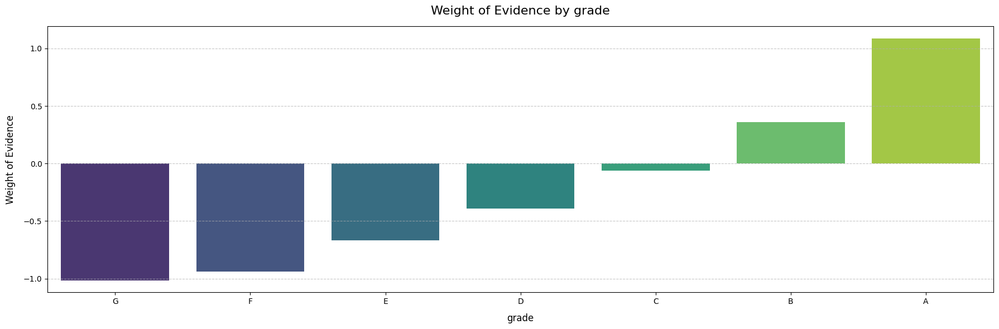

In [48]:
plot_by_woe_bar(df_temp)

In [49]:
# Home Owner variable

In [50]:
df_temp = woe_discrete(inputs_train,'home_ownership',targets_train)
df_temp

,home_ownership,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,NONE,44,0.840909,0.000118,37.0,7.0,0.000111,0.000175,-0.452604,NaN,NaN,inf
1,OTHER,130,0.853846,0.000348,111.0,19.0,0.000333,0.000474,-0.352521,0.012937,0.100083,inf
2,RENT,150880,0.876445,0.404474,132238.0,18642.0,0.397152,0.465329,-0.158426,0.022599,0.194095,inf
3,OWN,33428,0.893502,0.089613,29868.0,3560.0,0.089703,0.088862,0.009415,0.017058,0.167841,inf
4,MORTGAGE,188545,0.905413,0.505445,170711.0,17834.0,0.512698,0.445160,0.141253,0.011910,0.131838,inf
5,ANY,1,1.000000,0.000003,1.0,0.0,0.000003,0.000000,inf,0.094587,inf,inf


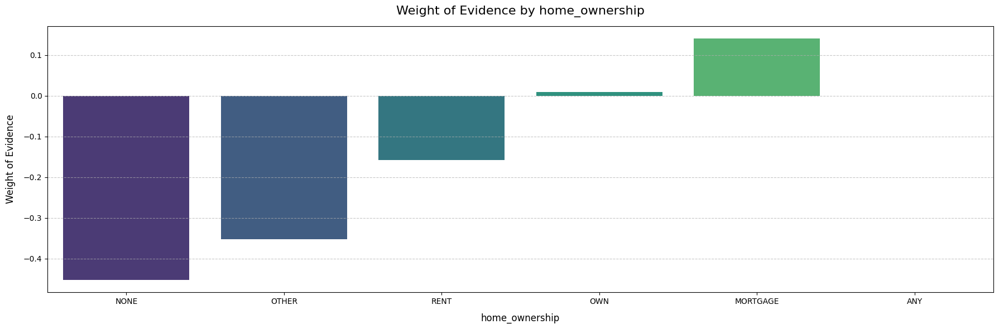

In [51]:
plot_by_woe_bar(df_temp)

In [52]:
# from the graph it is quite  evident that own and mortgage are the safest and None, Other and Rent are th riskiest
# but the values are quite few in  all of them so we will club all of these under a single column

inputs_train['home_ownership:RENT_OTHER_NONE_ANY'] = \
sum([inputs_train['home_ownership:RENT'], 
     inputs_train['home_ownership:OTHER'], 
     inputs_train['home_ownership:NONE'],
     inputs_train['home_ownership:ANY']])

In [53]:
df_temp = woe_discrete(inputs_train, 'addr_state', targets_train)
df_temp

,addr_state,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,NE,13,0.615385,0.000035,8.0,5.0,0.000024,0.000125,-1.647608,NaN,NaN,inf
1,NV,5174,0.868767,0.013870,4495.0,679.0,0.013500,0.016949,-0.227512,0.253382,1.420096,inf
2,HI,1987,0.870659,0.005327,1730.0,257.0,0.005196,0.006415,-0.210812,0.001892,0.016701,inf
3,FL,25289,0.878880,0.067794,22226.0,3063.0,0.066752,0.076456,-0.135744,0.008221,0.075067,inf
4,AL,4668,0.879392,0.012514,4105.0,563.0,0.012329,0.014053,-0.130931,0.000511,0.004813,inf
5,LA,4398,0.881764,0.011790,3878.0,520.0,0.011647,0.012980,-0.108366,0.002373,0.022565,inf
6,UT,2764,0.884588,0.007410,2445.0,319.0,0.007343,0.007963,-0.081003,0.002823,0.027363,inf
7,NY,32185,0.884667,0.086280,28473.0,3712.0,0.085513,0.092656,-0.080227,0.000079,0.000776,inf
8,NJ,14503,0.886644,0.038879,12859.0,1644.0,0.038620,0.041036,-0.060700,0.001977,0.019526,inf
9,MO,5958,0.886707,0.015972,5283.0,675.0,0.015866,0.016849,-0.060075,0.000063,0.000625,inf


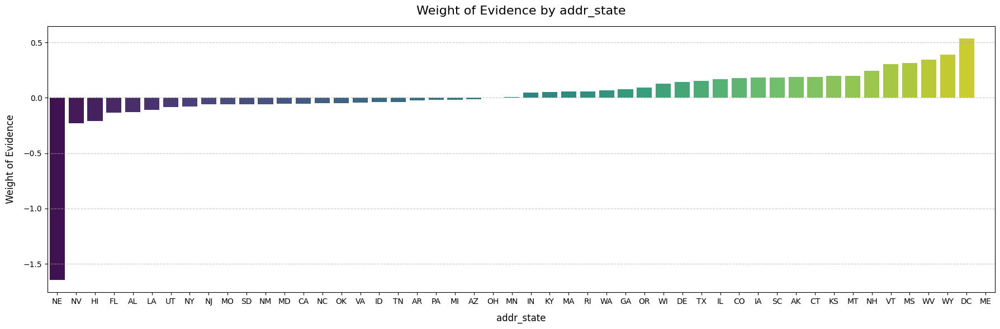

In [54]:
plot_by_woe_bar(df_temp)

In [55]:
# Since ND might be missing in dataframe
if ['addr_state:ND'] in inputs_train.columns.values:
    pass
else:
    inputs_train['addr_state:ND'] = 0

In [56]:
# We create the following categories:
# 'ND' 'NE' 'IA' NV' 'FL' 'HI' 'AL'
# 'NM' 'VA'
# 'NY'
# 'OK' 'TN' 'MO' 'LA' 'MD' 'NC'
# 'CA'
# 'UT' 'KY' 'AZ' 'NJ'
# 'AR' 'MI' 'PA' 'OH' 'MN'
# 'RI' 'MA' 'DE' 'SD' 'IN'
# 'GA' 'WA' 'OR'
# 'WI' 'MT'
# 'TX'
# 'IL' 'CT'
# 'KS' 'SC' 'CO' 'VT' 'AK' 'MS'
# 'WV' 'NH' 'WY' 'DC' 'ME' 'ID'

# 'IA_NV_HI_ID_AL_FL' will be the reference category. - the ones which are the most riskiest

inputs_train['addr_state:ND_NE_IA_NV_FL_HI_AL'] = \
sum([inputs_train['addr_state:ND'], inputs_train['addr_state:NE'], 
     inputs_train['addr_state:IA'], inputs_train['addr_state:NV'],
     inputs_train['addr_state:FL'], inputs_train['addr_state:HI'],
     inputs_train['addr_state:AL']])

inputs_train['addr_state:NM_VA'] = \
sum([inputs_train['addr_state:NM'], inputs_train['addr_state:VA']])

inputs_train['addr_state:OK_TN_MO_LA_MD_NC'] = \
sum([inputs_train['addr_state:OK'], inputs_train['addr_state:TN'],
     inputs_train['addr_state:MO'], inputs_train['addr_state:LA'],
     inputs_train['addr_state:MD'], inputs_train['addr_state:NC']])

inputs_train['addr_state:UT_KY_AZ_NJ'] = \
sum([inputs_train['addr_state:UT'], inputs_train['addr_state:KY'],
     inputs_train['addr_state:AZ'], inputs_train['addr_state:NJ']])

inputs_train['addr_state:AR_MI_PA_OH_MN'] = \
sum([inputs_train['addr_state:AR'], inputs_train['addr_state:MI'],
     inputs_train['addr_state:PA'], inputs_train['addr_state:OH'],
     inputs_train['addr_state:MN']])

inputs_train['addr_state:RI_MA_DE_SD_IN'] = \
sum([inputs_train['addr_state:RI'], inputs_train['addr_state:MA'],
     inputs_train['addr_state:DE'], inputs_train['addr_state:SD'],
     inputs_train['addr_state:IN']])

inputs_train['addr_state:GA_WA_OR'] = \
sum([inputs_train['addr_state:GA'], inputs_train['addr_state:WA'],
     inputs_train['addr_state:OR']])

inputs_train['addr_state:WI_MT'] = \
sum([inputs_train['addr_state:WI'], inputs_train['addr_state:MT']])

inputs_train['addr_state:IL_CT'] = \
sum([inputs_train['addr_state:IL'], inputs_train['addr_state:CT']])

inputs_train['addr_state:KS_SC_CO_VT_AK_MS'] = \
sum([inputs_train['addr_state:KS'], inputs_train['addr_state:SC'],
     inputs_train['addr_state:CO'], inputs_train['addr_state:VT'],
     inputs_train['addr_state:AK'], inputs_train['addr_state:MS']])

inputs_train['addr_state:WV_NH_WY_DC_ME_ID'] = \
sum([inputs_train['addr_state:WV'], inputs_train['addr_state:NH'],
     inputs_train['addr_state:WY'], inputs_train['addr_state:DC'],
     inputs_train['addr_state:ME'], inputs_train['addr_state:ID']])



In [57]:
df_temp = woe_discrete(inputs_train, 'verification_status', targets_train)
df_temp

,verification_status,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,Verified,134645,0.873943,0.360951,117672.0,16973.0,0.353405,0.423668,-0.181335,NaN,NaN,0.023945
1,Source Verified,119854,0.896933,0.321300,107501.0,12353.0,0.322859,0.308347,0.045989,0.02299,0.227324,0.023945
2,Not Verified,118529,0.909423,0.317748,107793.0,10736.0,0.323736,0.267985,0.188998,0.01249,0.143009,0.023945


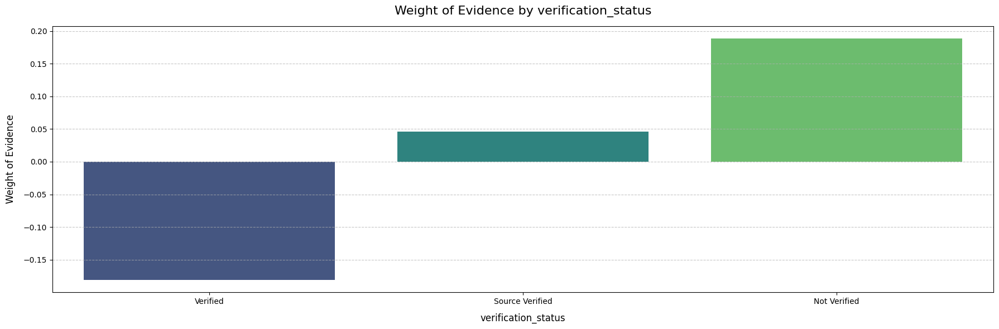

In [58]:
plot_by_woe_bar(df_temp)

In [59]:
df_temp = woe_discrete(inputs_train, 'purpose', targets_train)
df_temp

,purpose,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,small_business,5632,0.795099,0.015098,4478.0,1154.0,0.013449,0.028805,-0.761670,NaN,NaN,0.032998
1,moving,2378,0.848612,0.006375,2018.0,360.0,0.006061,0.008986,-0.393854,0.053513,0.367816,0.032998
2,renewable_energy,287,0.850174,0.000769,244.0,43.0,0.000733,0.001073,-0.381644,0.001562,0.012210,0.032998
3,house,1802,0.865150,0.004831,1559.0,243.0,0.004682,0.006066,-0.258874,0.014976,0.122770,0.032998
4,other,19002,0.867698,0.050940,16488.0,2514.0,0.049519,0.062753,-0.236854,0.002548,0.022019,0.032998
5,medical,3664,0.871179,0.009822,3192.0,472.0,0.009587,0.011782,-0.206188,0.003481,0.030666,0.032998
6,educational,337,0.872404,0.000903,294.0,43.0,0.000883,0.001073,-0.195232,0.001225,0.010956,0.032998
7,debt_consolidation,219381,0.888135,0.588109,194840.0,24541.0,0.585165,0.612576,-0.045779,0.015732,0.149454,0.032998
8,vacation,1992,0.889056,0.005340,1771.0,221.0,0.005319,0.005516,-0.036475,0.000921,0.009303,0.032998
9,wedding,1880,0.890957,0.005040,1675.0,205.0,0.005031,0.005117,-0.017054,0.001901,0.019422,0.032998


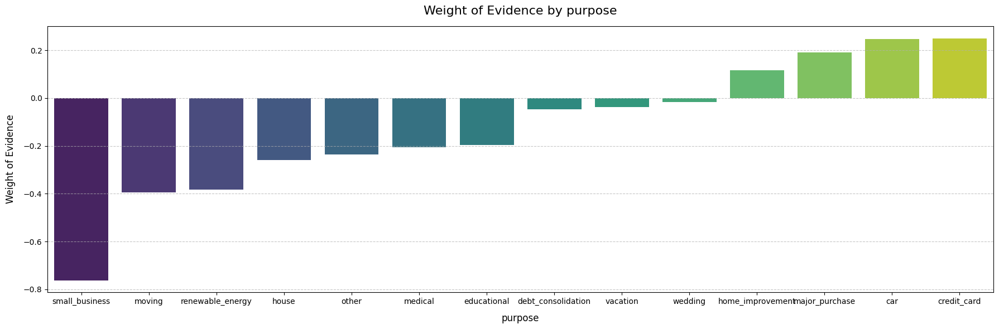

In [60]:
plot_by_woe_bar(df_temp)

In [61]:
# Combine 'educational', 'small_business', 'wedding', 'renewable_energy', 
#   'moving', 'house' in one category: 'educ__sm_b__wedd__ren_en__mov__house'.
# Combine 'other', 'medical', 'vacation' in one category: 'oth__med__vacation'.
# Combine 'major_purchase', 'car', 'home_improvement' in one category: 'major_purch__car__home_impr'.
# Leave 'debt_consolidtion' in a separate category.
# Leave 'credit_card' in a separate category.
# 'educ__sm_b__wedd__ren_en__mov__house' will be the reference category.

inputs_train['purpose:educ__sm_b__wedd__ren_en__mov__house'] = \
sum([inputs_train['purpose:educational'], inputs_train['purpose:small_business'],
     inputs_train['purpose:wedding'], inputs_train['purpose:renewable_energy'],
     inputs_train['purpose:moving'], inputs_train['purpose:house']])

inputs_train['purpose:oth__med__vacation'] = \
sum([inputs_train['purpose:other'], inputs_train['purpose:medical'],
     inputs_train['purpose:vacation']])

inputs_train['purpose:major_purch__car__home_impr'] = \
sum([inputs_train['purpose:major_purchase'], inputs_train['purpose:car'],
     inputs_train['purpose:home_improvement']])


## WoE for the Continous Varaible

In [62]:
# WoE function for ordered discrete and continuous variables
def woe_ordered_continuous(df, discrete_variabe_name, good_bad_variable_df):
    df = pd.concat([df[discrete_variabe_name], good_bad_variable_df], axis = 1)
    df = pd.concat([df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].count(),
                    df.groupby(df.columns.values[0], as_index = False)[df.columns.values[1]].mean()], axis = 1)
    df = df.iloc[:, [0, 1, 3]]
    df.columns = [df.columns.values[0], 'n_obs', 'prop_good']
    df['prop_n_obs'] = df['n_obs'] / df['n_obs'].sum()
    df['n_good'] = df['prop_good'] * df['n_obs']
    df['n_bad'] = (1 - df['prop_good']) * df['n_obs']
    df['prop_n_good'] = df['n_good'] / df['n_good'].sum()
    df['prop_n_bad'] = df['n_bad'] / df['n_bad'].sum()
    df['WoE'] = np.log(df['prop_n_good'] / df['prop_n_bad'])
    #df = df.sort_values(['WoE'])
    #df = df.reset_index(drop = True)
    df['diff_prop_good'] = df['prop_good'].diff().abs()
    df['diff_WoE'] = df['WoE'].diff().abs()
    df['IV'] = (df['prop_n_good'] - df['prop_n_bad']) * df['WoE']
    df['IV'] = df['IV'].sum()
    return df

In [63]:
df_temp = woe_ordered_continuous(inputs_train, 'term_int', targets_train)
df_temp

,term_int,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,36,270458,0.905061,0.725034,244781.0,25677.0,0.735153,0.640932,0.137156,NaN,NaN,0.0416
1,60,102570,0.859754,0.274966,88185.0,14385.0,0.264847,0.359068,-0.304361,0.045307,0.441517,0.0416


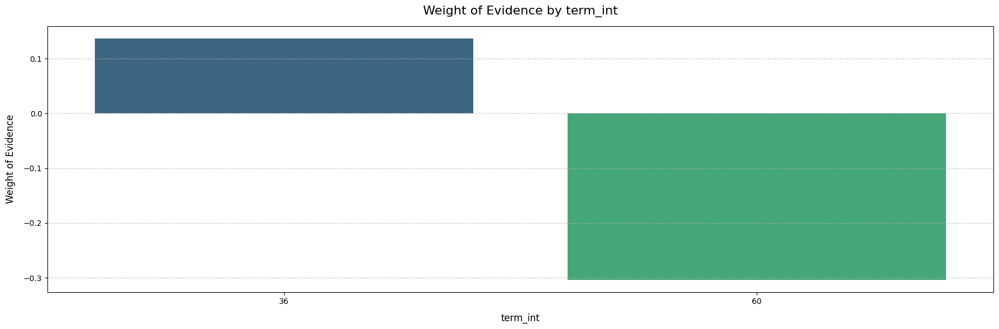

In [64]:
plot_by_woe_bar(df_temp)

In [65]:
inputs_train['term:36'] = np.where((inputs_train['term_int'] == 36), 1, 0)
inputs_train['term:60'] = np.where((inputs_train['term_int'] == 60), 1, 0)


In [66]:
df_temp = woe_ordered_continuous(inputs_train, 'emp_length_int', targets_train)
df_temp

,emp_length_int,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,0.0,45847,0.879970,0.122905,40344.0,5503.0,0.121166,0.137362,-0.125463,NaN,NaN,0.005462
1,1.0,23806,0.890826,0.063818,21207.0,2599.0,0.063691,0.064874,-0.018408,0.010856,0.107055,0.005462
2,2.0,33003,0.892646,0.088473,29460.0,3543.0,0.088478,0.088438,0.000447,0.001820,0.018855,0.005462
3,3.0,29279,0.892858,0.078490,26142.0,3137.0,0.078513,0.078304,0.002664,0.000212,0.002217,0.005462
4,4.0,22503,0.893170,0.060325,20099.0,2404.0,0.060364,0.060007,0.005924,0.000311,0.003260,0.005462
5,5.0,24522,0.886265,0.065738,21733.0,2789.0,0.065271,0.069617,-0.064463,0.006904,0.070387,0.005462
6,6.0,20778,0.885552,0.055701,18400.0,2378.0,0.055261,0.059358,-0.071521,0.000713,0.007058,0.005462
7,7.0,20934,0.889558,0.056119,18622.0,2312.0,0.055928,0.057711,-0.031381,0.004006,0.040140,0.005462
8,8.0,17830,0.892092,0.047798,15906.0,1924.0,0.047771,0.048026,-0.005322,0.002534,0.026059,0.005462
9,9.0,14368,0.888363,0.038517,12764.0,1604.0,0.038334,0.040038,-0.043484,0.003729,0.038162,0.005462


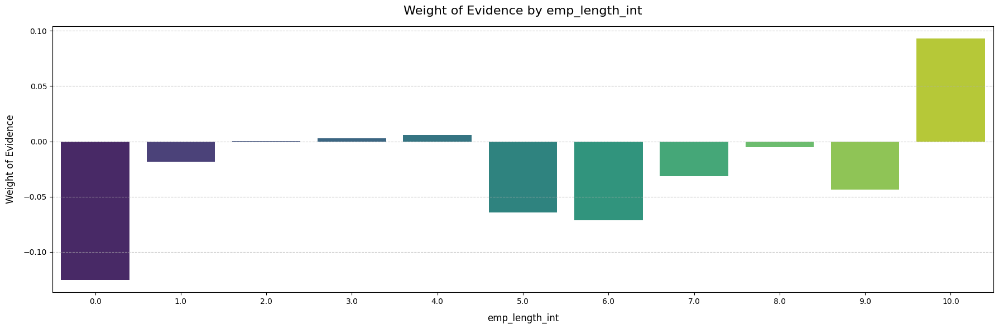

In [67]:
plot_by_woe_bar(df_temp)

In [69]:
# creating categories for the employement length
# Buckets created - 0,1, 2-5,5-7,7-10 and 10
inputs_train['emp_length:0'] = \
np.where(inputs_train['emp_length_int'].isin([0]), 1, 0)
inputs_train['emp_length:1'] = \
np.where(inputs_train['emp_length_int'].isin([1]), 1, 0)
inputs_train['emp_length:2-4'] = \
np.where(inputs_train['emp_length_int'].isin(range(2, 5)), 1, 0)
inputs_train['emp_length:5-6'] = \
np.where(inputs_train['emp_length_int'].isin(range(5, 7)), 1, 0)
inputs_train['emp_length:7-9'] = \
np.where(inputs_train['emp_length_int'].isin(range(7, 10)), 1, 0)
inputs_train['emp_length:10'] = \
np.where(inputs_train['emp_length_int'].isin([10]), 1, 0)


In [76]:
inputs_train['mths_since_issue_d'].unique()

array([ 69.,  43.,  54.,  42.,  38.,  64.,  62.,  57.,  85.,  58.,  65.,
        71.,  53.,  48.,  37.,  56.,  46.,  39.,  41.,  50.,  59.,  86.,
        55.,  72.,  45.,  44.,  63.,  47.,  49.,  51.,  60.,  52.,  66.,
        97.,  87.,  73.,  70.,  92.,  78.,  83.,  75., 112.,  67.,  81.,
       121.,  68., 100.,  40., 118.,  61.,  74.,  76., 101.,  98.,  77.,
        79.,  95.,  89.,  82.,  90.,  80.,  88., 119., 115.,  94.,  99.,
       117., 124.,  84., 108., 111., 114.,  93.,  96., 102., 120.,  91.,
       104., 105., 109., 106., 116., 123., 122., 107., 125., 110., 126.,
       113., 128., 127.])

In [ ]:
# note -  moths_since_issue_d is a calculated column
# what is being done here - we are creating Bins of 50 for the month since issued column
inputs_train['mths_since_issue_d_factor'] = pd.cut(inputs_train['mths_since_issue_d'], 50)
inputs_train['mths_since_issue_d_factor']

221233      (67.94, 69.76]
378461      (42.46, 44.28]
117522       (53.38, 55.2]
352107      (40.64, 42.46]
253931     (36.909, 38.82]
197856       (62.48, 64.3]
185307      (60.66, 62.48]
145527       (55.2, 57.02]
22919       (84.32, 86.14]
355028      (40.64, 42.46]
160609      (57.02, 58.84]
372833      (42.46, 44.28]
364006      (40.64, 42.46]
205790       (64.3, 66.12]
205119       (64.3, 66.12]
226521      (69.76, 71.58]
108093      (51.56, 53.38]
114304       (53.38, 55.2]
463381      (47.92, 49.74]
451532      (47.92, 49.74]
233359     (36.909, 38.82]
143671       (55.2, 57.02]
418765       (44.28, 46.1]
231610     (36.909, 38.82]
290970      (38.82, 40.64]
334673      (40.64, 42.46]
70503       (49.74, 51.56]
164789      (58.84, 60.66]
146506       (55.2, 57.02]
23021       (84.32, 86.14]
161592      (58.84, 60.66]
156827      (57.02, 58.84]
167189      (58.84, 60.66]
232965     (36.909, 38.82]
126196       (53.38, 55.2]
460401      (47.92, 49.74]
230444       (71.58, 73.4]
4

In [73]:
df_temp = woe_ordered_continuous(inputs_train, 'mths_since_issue_d_factor', targets_train)
df_temp

,mths_since_issue_d_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(36.909, 38.82]",28321,0.943187,0.075922,26712.0,1609.0,0.080224,0.040163,0.691888,NaN,NaN,inf
1,"(38.82, 40.64]",39625,0.928555,0.106225,36794.0,2831.0,0.110504,0.070665,0.447093,0.014632,0.244795,inf
2,"(40.64, 42.46]",38418,0.916836,0.102990,35223.0,3195.0,0.105786,0.079751,0.282500,0.011719,0.164593,inf
3,"(42.46, 44.28]",28945,0.908896,0.077595,26308.0,2637.0,0.079011,0.065823,0.182619,0.007940,0.099881,inf
4,"(44.28, 46.1]",28278,0.902044,0.075807,25508.0,2770.0,0.076608,0.069143,0.102533,0.006852,0.080086,inf
5,"(46.1, 47.92]",12219,0.900074,0.032756,10998.0,1221.0,0.033030,0.030478,0.080431,0.001970,0.022102,inf
6,"(47.92, 49.74]",24532,0.898337,0.065765,22038.0,2494.0,0.066187,0.062254,0.061268,0.001737,0.019163,inf
7,"(49.74, 51.56]",23000,0.887957,0.061658,20423.0,2577.0,0.061337,0.064325,-0.047576,0.010380,0.108845,inf
8,"(51.56, 53.38]",20637,0.880554,0.055323,18172.0,2465.0,0.054576,0.061530,-0.119922,0.007402,0.072346,inf
9,"(53.38, 55.2]",18268,0.867528,0.048972,15848.0,2420.0,0.047596,0.060406,-0.238336,0.013026,0.118414,inf


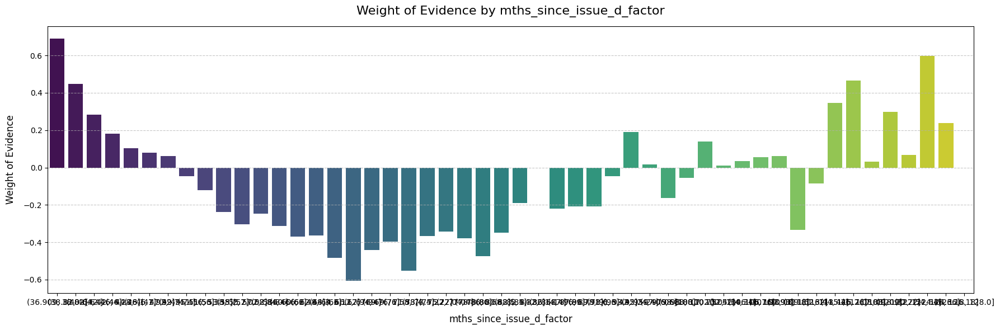

In [74]:
plot_by_woe_bar(df_temp)

In [77]:
# We create the following categories:
# < 38, 38 - 39, 40 - 41, 42 - 48, 49 - 52, 53 - 64, 65 - 84, > 84.
inputs_train['mths_since_issue_d:<38'] = \
np.where(inputs_train['mths_since_issue_d'].isin(range(38)), 1, 0)
inputs_train['mths_since_issue_d:38-39'] = \
np.where(inputs_train['mths_since_issue_d'].isin(range(38, 40)), 1, 0)
inputs_train['mths_since_issue_d:40-41'] = \
np.where(inputs_train['mths_since_issue_d'].isin(range(40, 42)), 1, 0)
inputs_train['mths_since_issue_d:42-48'] = \
np.where(inputs_train['mths_since_issue_d'].isin(range(42, 49)), 1, 0)
inputs_train['mths_since_issue_d:49-52'] = \
np.where(inputs_train['mths_since_issue_d'].isin(range(49, 53)), 1, 0)
inputs_train['mths_since_issue_d:53-64'] = \
np.where(inputs_train['mths_since_issue_d'].isin(range(53, 65)), 1, 0)
inputs_train['mths_since_issue_d:65-84'] = \
np.where(inputs_train['mths_since_issue_d'].isin(range(65, 85)), 1, 0)
inputs_train['mths_since_issue_d:>84'] = \
np.where(inputs_train['mths_since_issue_d'].isin(range(85, int(inputs_train['mths_since_issue_d'].max()))), 1, 0)


In [78]:
# interest rate factor --

inputs_train['int_rate_factor'] = pd.cut(inputs_train['int_rate'], 50)

In [79]:
df_temp = woe_ordered_continuous(inputs_train, 'int_rate_factor', targets_train)
df_temp

,int_rate_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(5.399, 5.833]",784,0.965561,0.002102,757.0,27.0,0.002274,0.000674,1.215914,NaN,NaN,0.348258
1,"(5.833, 6.246]",8400,0.979405,0.022518,8227.0,173.0,0.024708,0.004318,1.744273,0.013844,0.528359,0.348258
2,"(6.246, 6.658]",7856,0.971359,0.021060,7631.0,225.0,0.022918,0.005616,1.406262,0.008045,0.338011,0.348258
3,"(6.658, 7.071]",1871,0.969001,0.005016,1813.0,58.0,0.005445,0.001448,1.324683,0.002359,0.081579,0.348258
4,"(7.071, 7.484]",3177,0.977967,0.008517,3107.0,70.0,0.009331,0.001747,1.675306,0.008966,0.350622,0.348258
5,"(7.484, 7.897]",12656,0.962626,0.033928,12183.0,473.0,0.036589,0.011807,1.131089,0.015340,0.544216,0.348258
6,"(7.897, 8.31]",9706,0.949104,0.026019,9212.0,494.0,0.027666,0.012331,0.808115,0.013523,0.322975,0.348258
7,"(8.31, 8.722]",6592,0.966019,0.017672,6368.0,224.0,0.019125,0.005591,1.229783,0.016916,0.421668,0.348258
8,"(8.722, 9.135]",9540,0.938784,0.025574,8956.0,584.0,0.026898,0.014577,0.612566,0.027235,0.617217,0.348258
9,"(9.135, 9.548]",6645,0.967645,0.017814,6430.0,215.0,0.019311,0.005367,1.280480,0.028861,0.667914,0.348258


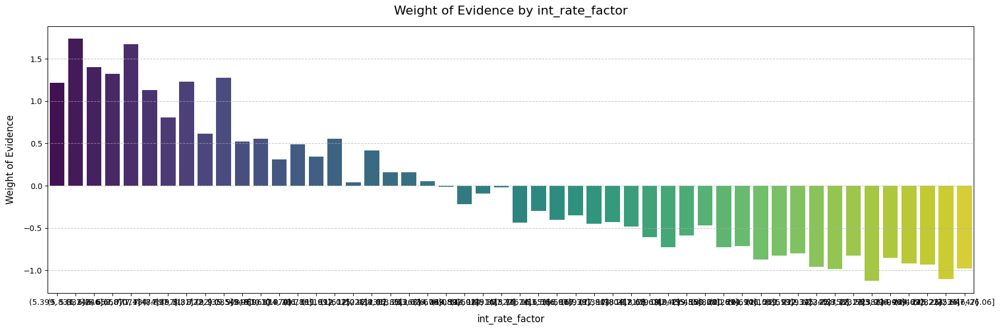

In [80]:
plot_by_woe_bar(df_temp)

In [81]:
# '< 9.548', '9.548 - 12.025', '12.025 - 15.74', '15.74 - 20.281', '> 20.281' -- categories of the interest factor
inputs_train['int_rate:<9.548'] = \
np.where((inputs_train['int_rate'] <= 9.548), 1, 0)
inputs_train['int_rate:9.548-12.025'] = \
np.where((inputs_train['int_rate'] > 9.548) & (inputs_train['int_rate'] <= 12.025), 1, 0)
inputs_train['int_rate:12.025-15.74'] = \
np.where((inputs_train['int_rate'] > 12.025) & (inputs_train['int_rate'] <= 15.74), 1, 0)
inputs_train['int_rate:15.74-20.281'] = \
np.where((inputs_train['int_rate'] > 15.74) & (inputs_train['int_rate'] <= 20.281), 1, 0)
inputs_train['int_rate:>20.281'] = \
np.where((inputs_train['int_rate'] > 20.281), 1, 0)


In [83]:
## funded amount -- variable of interest

inputs_train['funded_amnt_factor'] = pd.cut(inputs_train['funded_amnt'],50)
df_temp = woe_ordered_continuous(inputs_train, 'funded_amnt_factor', targets_train)
df_temp


,funded_amnt_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(465.5, 1190.0]",1252,0.910543,0.003356,1140.0,112.0,0.003424,0.002796,0.202673,NaN,NaN,0.015716
1,"(1190.0, 1880.0]",3040,0.909211,0.008150,2764.0,276.0,0.008301,0.006889,0.186421,0.001333,0.016251,0.015716
2,"(1880.0, 2570.0]",6025,0.901245,0.016152,5430.0,595.0,0.016308,0.014852,0.093521,0.007966,0.092900,0.015716
3,"(2570.0, 3260.0]",7261,0.894780,0.019465,6497.0,764.0,0.019513,0.019070,0.022916,0.006464,0.070605,0.015716
4,"(3260.0, 3950.0]",4789,0.898726,0.012838,4304.0,485.0,0.012926,0.012106,0.065539,0.003946,0.042623,0.015716
5,"(3950.0, 4640.0]",9015,0.894620,0.024167,8065.0,950.0,0.024222,0.023713,0.021215,0.004106,0.044324,0.015716
6,"(4640.0, 5330.0]",15865,0.897195,0.042530,14234.0,1631.0,0.042749,0.040712,0.048828,0.002575,0.027613,0.015716
7,"(5330.0, 6020.0]",17138,0.908799,0.045943,15575.0,1563.0,0.046777,0.039015,0.181448,0.011604,0.132620,0.015716
8,"(6020.0, 6710.0]",6926,0.887237,0.018567,6145.0,781.0,0.018455,0.019495,-0.054793,0.021563,0.236241,0.015716
9,"(6710.0, 7400.0]",11726,0.900307,0.031435,10557.0,1169.0,0.031706,0.029180,0.083028,0.013071,0.137822,0.015716


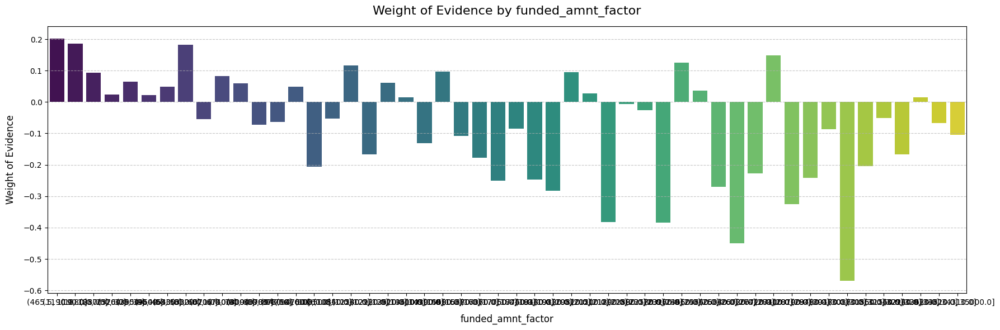

In [84]:
plot_by_woe_bar(df_temp)

In [85]:
# seems like there is no relation between this and the target variable and thus we are not creating any dummy variable

In [87]:
#  months since earliest credit line -- variable into considerations
# 516 is the count of unique months

len(inputs_train['mths_since_earliest_cr_line'].unique())

516

In [88]:
inputs_train['mths_since_earliest_cr_line_factor'] = pd.cut(inputs_train['mths_since_earliest_cr_line'], 50)
inputs_train['mths_since_earliest_cr_line_factor']

221233      (5659948.8, 6174489.6]
378461    (12863520.0, 13378060.8]
117522    (13892601.6, 14407142.4]
352107      (9261734.4, 9776275.2]
253931    (10290816.0, 10805356.8]
197856      (8232652.8, 8747193.6]
185307      (7718112.0, 8232652.8]
145527    (15436224.0, 15950764.8]
22919      (9776275.2, 10290816.0]
355028      (3601785.6, 4116326.4]
160609    (12348979.2, 12863520.0]
372833      (7203571.2, 7718112.0]
364006    (15950764.8, 16465305.6]
205790    (15950764.8, 16465305.6]
205119      (7718112.0, 8232652.8]
226521    (12348979.2, 12863520.0]
108093      (7203571.2, 7718112.0]
114304    (10290816.0, 10805356.8]
463381      (7203571.2, 7718112.0]
451532    (10805356.8, 11319897.6]
233359    (14921683.2, 15436224.0]
143671    (11834438.4, 12348979.2]
418765      (8232652.8, 8747193.6]
231610    (10290816.0, 10805356.8]
290970      (6689030.4, 7203571.2]
334673      (7718112.0, 8232652.8]
70503       (8232652.8, 8747193.6]
164789    (13892601.6, 14407142.4]
146506    (10290816.

In [89]:
df_temp = woe_ordered_continuous(inputs_train, 'mths_since_earliest_cr_line_factor', targets_train)
df_temp

,mths_since_earliest_cr_line_factor,n_obs,prop_good,prop_n_obs,n_good,n_bad,prop_n_good,prop_n_bad,WoE,diff_prop_good,diff_WoE,IV
0,"(-25727.04, 514540.8]",26,1.000000,0.000070,26.0,0.0,0.000078,0.000000,inf,NaN,NaN,inf
1,"(514540.8, 1029081.6]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
2,"(1029081.6, 1543622.4]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
3,"(1543622.4, 2058163.2]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
4,"(2058163.2, 2572704.0]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
5,"(2572704.0, 3087244.8]",0,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,inf
6,"(3087244.8, 3601785.6]",738,0.906504,0.001978,669.0,69.0,0.002009,0.001722,0.154065,NaN,NaN,inf
7,"(3601785.6, 4116326.4]",1931,0.890730,0.005177,1720.0,211.0,0.005166,0.005267,-0.019391,0.015774,0.173456,inf
8,"(4116326.4, 4630867.2]",2845,0.854482,0.007627,2431.0,414.0,0.007301,0.010334,-0.347420,0.036249,0.328029,inf
9,"(4630867.2, 5145408.0]",5097,0.871101,0.013664,4440.0,657.0,0.013335,0.016400,-0.206886,0.016619,0.140534,inf


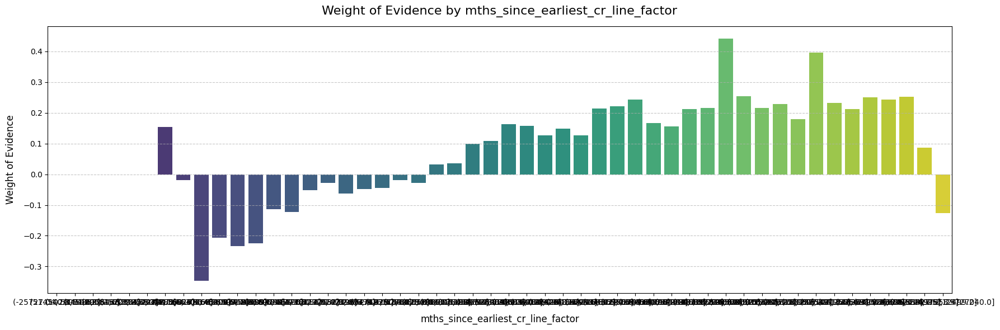

In [90]:
plot_by_woe_bar(df_temp)